In [1]:
import os
import numpy as np
import pandas as pd
import scanpy as sc
import anndata 
import seaborn as sns
from scipy.stats import zscore
from scipy import sparse 
import itertools

import matplotlib.pyplot as plt
import collections
from sklearn.cluster import KMeans
from sklearn import metrics

from sklearn.decomposition import PCA
from umap import UMAP

from matplotlib.colors import LinearSegmentedColormap

from scroutines.config_plots import *
from scroutines import powerplots # .config_plots import *
from scroutines import pnmf
from scroutines import basicu


In [2]:
outdir     = "/u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/results"
outfigdir = "/u/home/f/f7xiesnm/project-zipursky/v1-bb/ms_reanalysis/"

In [3]:
adata_raw = anndata.read("../../data/cheng21_cell_scrna/reorganized/all_IT.h5ad")
adata_raw = adata_raw[adata_raw.obs['Subclass']=='L2/3']
adata_raw = adata_raw[adata_raw.obs['cond'].isin(['P28NR', 'P28DR'])]
counts = adata_raw.X
allgenes = adata_raw.var.index.values
adata_raw

View of AnnData object with n_obs × n_vars = 8748 × 53801
    obs: 'Class_broad', 'Doublet', 'Doublet Score', 'batch', 'leiden', 'n_counts', 'n_genes', 'percent_mito', 'sample', 'Type', 'Subclass', 'cond'

In [4]:
# get updated cell types
f = "/u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/results/allL23_newtypes.csv"
meta = pd.read_csv(f, index_col=0)
meta

/tmp/ipykernel_114441/12491127.py:3: DtypeWarning: Columns (1,4) have mixed types. Specify dtype option on import or set low_memory=False.
  meta = pd.read_csv(f, index_col=0)


,Class_broad,Doublet,Doublet Score,batch,leiden,n_counts,n_genes,percent_mito,sample,Type,Subclass,cond,easitype,umap1,umap2,easisample,easicond,newtype
AAACGCTCACTTCATT-1-P8_1a-P8,Excitatory,False,0.025713,1,0,23384.0,4943,0.000128,P8_1a,L2/3_AB,L2/3,P8NR,L2/3_A,NaN,NaN,1a,1-P08NR,L2/3_A
AAAGGATAGGTGCATG-1-P8_1a-P8,Excitatory,False,0.011883,1,0,17774.0,4698,0.000169,P8_1a,L2/3_AB,L2/3,P8NR,L2/3_A,NaN,NaN,1a,1-P08NR,L2/3_A
AAAGGGCCAGTATACC-1-P8_1a-P8,Excitatory,False,0.024667,1,0,15872.0,4173,0.000126,P8_1a,L2/3_AB,L2/3,P8NR,L2/3_A,NaN,NaN,1a,1-P08NR,L2/3_A
AAAGTCCCATATACCG-1-P8_1a-P8,Excitatory,False,0.027921,1,0,20076.0,4761,0.000050,P8_1a,L2/3_AB,L2/3,P8NR,L2/3_A,NaN,NaN,1a,1-P08NR,L2/3_A
AAAGTCCTCAGATGCT-1-P8_1a-P8,Excitatory,False,0.009527,1,4,19061.0,4601,0.000000,P8_1a,L2/3_BC,L2/3,P8NR,L2/3_C,NaN,NaN,1a,1-P08NR,L2/3_C
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGGTTCAGTTGTTG-1-P38_dr_1a,NaN,False,0.042872,11,1,11379.0,3568,0.000879,P38_dr_1a,L2/3_3,L2/3,P38DR,L2/3_C,NaN,NaN,1a,2-P38DR,L2/3_B
TTTGGTTTCTGCCTGT-1-P38_dr_2b,NaN,False,0.007108,2,1,16050.0,3104,0.000062,P38_dr_2b,L2/3_3,L2/3,P38DR,L2/3_C,NaN,NaN,2b,2-P38DR,L2/3_B
TTTGTTGCACCGGTCA-1-P38_dr_2a,NaN,False,0.030928,2,1,13955.0,3739,0.001146,P38_dr_2a,L2/3_3,L2/3,P38DR,L2/3_C,NaN,NaN,2a,2-P38DR,L2/3_B
TTTGTTGGTGGCTAGA-1-P38_dr_2b,NaN,False,0.015884,3,4,7272.0,2789,0.000963,P38_dr_2b,L2/3_2,L2/3,P38DR,L2/3_B,NaN,NaN,2b,2-P38DR,L2/3_A


In [5]:
# update new type 
adata_raw.obs['newtype'] = adata_raw.obs['Type'].copy()
adata_raw.obs.update(meta[['newtype']])

/tmp/ipykernel_114441/3478751590.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_raw.obs['newtype'] = adata_raw.obs['Type'].copy()


In [6]:
conds = adata_raw.obs['cond'].values
types = adata_raw.obs['Type'].values
newtypes = adata_raw.obs['newtype'].values
samps = adata_raw.obs['sample'].values

rename_dict = {
    "L2/3_A": "L2/3_A",
    "L2/3_B": "L2/3_B",
    "L2/3_C": "L2/3_C",
    
    "L2/3_1": "L2/3_A",
    "L2/3_2": "L2/3_B",
    "L2/3_3": "L2/3_C",
    
    "L2/3_AB": "L2/3_A",
    "L2/3_BC": "L2/3_C",
}

def rename(x):
    """
    """
    if x in rename_dict.keys():
        return rename_dict[x]
    else:
        return x
    
adata_raw.obs['easitype'] = adata_raw.obs['Type'].apply(rename)

In [7]:
f = '/u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/results/P28NR_ITgrad_genes_n749_n338unq_230420.csv'
df2 = pd.read_csv(f)
genes_it = df2['gene'].unique()
# genes_it

In [8]:
# use those 286 genes
# df = pd.read_csv("../../data/cheng21_cell_scrna/res/candidate_genes_vincent_0503_v2.csv")
df = pd.read_csv("../../data/cheng21_cell_scrna/res/L23-ABC-genes-n288-n286unq-annot.csv")
genes_l23 = df['gene'].values
# genes_sel = adata_raw.var.index.values
# genes_grp = df['P17on'].astype(str).values
# assert len(genes_sel) == len(np.unique(genes_sel))

# Use P28 ordering
f = '../../results/gene_ptime_P28_L23_Mar27.tsv'
gpt = pd.read_csv(f)
gpt = gpt['gene_ptime'].values
gptidx = np.argsort(gpt)

In [9]:
genes_it.shape, genes_l23.shape, np.intersect1d(genes_it, genes_l23).shape

((338,), (286,), (89,))

In [10]:
# filter genes
cond = np.ravel((adata_raw.X>0).sum(axis=0)) > 10 # expressed in more than 10 cells
adata_sub = adata_raw[:,cond]

# counts
x = adata_sub.X
cov = adata_sub.obs['n_counts'].values
genes = adata_sub.var.index.values

# CP10k
xn = (sparse.diags(1/cov).dot(x))*1e4

# log10(CP10k+1)
xln = xn.copy()
xln.data = np.log10(xln.data+1)

adata_sub.layers['norm'] = xn
adata_sub.layers['lognorm'] = xln

In [11]:
adata_sub.shape

(8748, 21222)

In [12]:
# select HVGs with mean and var
nbin = 20
qth = 0.3

# min
gm = np.ravel(xn.mean(axis=0))

# var
tmp = xn.copy()
tmp.data = np.power(tmp.data, 2)
gv = np.ravel(tmp.mean(axis=0))-gm**2

# cut 
lbl = pd.qcut(gm, nbin, labels=np.arange(nbin))
gres = pd.DataFrame()
gres['name'] = genes
gres['lbl'] = lbl
gres['mean'] = gm
gres['var'] = gv
gres['ratio']= gv/gm

# select
gres_sel = gres.groupby('lbl')['ratio'].nlargest(int(qth*(len(gm)/nbin))) #.reset_index()
gsel_idx = np.sort(gres_sel.index.get_level_values(1).values)

assert np.all(gsel_idx != -1)

In [13]:
l23_gidx = basicu.get_index_from_array(genes, genes_l23)
assert np.all(l23_gidx != -1)

it_gidx = basicu.get_index_from_array(genes, genes_it)
assert np.all(it_gidx != -1)

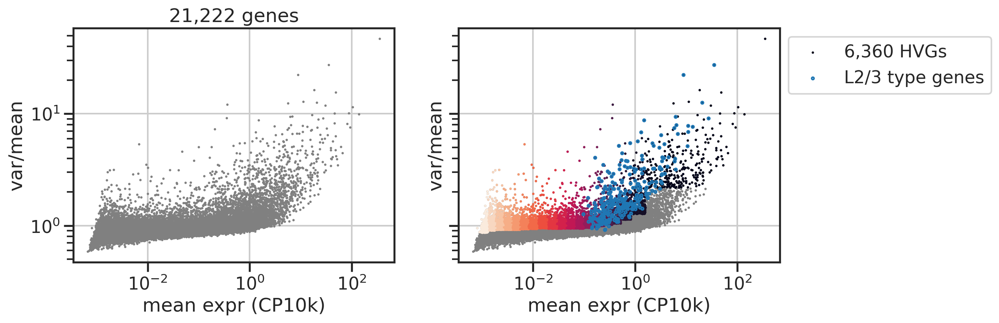

In [14]:
fig, axs = plt.subplots(1,2, figsize=(6*2,4), sharex=True, sharey=True)
ax = axs[0]
ax.scatter(gm, gv/gm, s=5, edgecolor='none', color='gray')
ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlabel('mean expr (CP10k)')
ax.set_ylabel('var/mean')
ax.set_title(f'{len(gm):,} genes')

ax = axs[1]
ax.scatter(gm, gv/gm, s=5, edgecolor='none', color='gray')
ax.scatter(gm[gsel_idx], (gv/gm)[gsel_idx], c=lbl[gsel_idx], s=5, edgecolor='none', cmap='rocket_r', label=f'{len(gsel_idx):,} HVGs')
ax.scatter(gm[l23_gidx], (gv/gm)[l23_gidx], s=5, facecolors='none', edgecolor='C0', label='L2/3 type genes')
# ax.scatter(gm[it_gidx], (gv/gm)[it_gidx], s=5, facecolors='none', edgecolor='C1', label='IT genes')
ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlabel('mean expr (CP10k)')
ax.set_ylabel('var/mean')
ax.legend(bbox_to_anchor=(1,1))

plt.show()

In [15]:
adata = adata_sub[:,gsel_idx]
# adata = adata_sub[:,it_gidx]
genes_sel = adata.var.index.values
lognorm = np.array(adata.layers['lognorm'].todense())
zlognorm = zscore(lognorm, axis=0)
adata

View of AnnData object with n_obs × n_vars = 8748 × 6360
    obs: 'Class_broad', 'Doublet', 'Doublet Score', 'batch', 'leiden', 'n_counts', 'n_genes', 'percent_mito', 'sample', 'Type', 'Subclass', 'cond', 'newtype', 'easitype'
    layers: 'norm', 'lognorm'

In [16]:
%%time
np.random.seed(0)
pca = PCA(n_components=50)
pcs = pca.fit_transform(zlognorm)
ucs = UMAP(n_components=2, n_neighbors=50).fit_transform(pcs)

CPU times: user 14min 26s, sys: 5.26 s, total: 14min 31s
Wall time: 46.4 s


In [37]:
# use enrichr API - network issues on hoffman2
output = os.path.join(outfigdir, 'pc1_top100.txt')
pc1_v = pca.components_[0]
pc1_idx = np.argsort(np.abs(pc1_v))[::-1]
np.savetxt(output, genes_sel[pc1_idx[:100]], fmt='%s')

output = os.path.join(outfigdir, 'pc2_top100.txt')
pc2_v = pca.components_[1]
pc2_idx = np.argsort(np.abs(pc2_v))[::-1]
np.savetxt(output, genes_sel[pc2_idx[:100]], fmt='%s')

output = os.path.join(outfigdir, 'pc3_top100.txt')
pc3_v = pca.components_[2]
pc3_idx = np.argsort(np.abs(pc3_v))[::-1]
np.savetxt(output, genes_sel[pc3_idx[:100]], fmt='%s')

output = os.path.join(outfigdir, 'pc4_top100.txt')
pc4_v = pca.components_[3]
pc4_idx = np.argsort(np.abs(pc4_v))[::-1]
np.savetxt(output, genes_sel[pc4_idx[:100]], fmt='%s')

In [17]:
# get results
res = pd.DataFrame(pcs, columns=np.char.add("PC", ((1+np.arange(pcs.shape[1])).astype(str))))
res['cond'] = conds
res['type'] = types
res['newtype'] = newtypes
res['samp'] = samps
res['biosamp'] = res['samp'].apply(lambda x: x[:-1])
res['umap1'] = ucs[:,0]
res['umap2'] = ucs[:,1]
res

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,...,PC48,PC49,PC50,cond,type,newtype,samp,biosamp,umap1,umap2
0,4.427578,-9.689540,1.838086,7.823680,-4.414385,-1.896773,-6.279955,-0.899321,0.840910,0.964638,...,2.086028,0.125468,2.960706,P28NR,L2/3_C,L2/3_B,P28_1a,P28_1,0.852589,-0.550992
1,-6.982108,-9.374791,3.692406,-11.023359,1.974236,0.040736,-0.917320,-1.941714,4.870755,1.141895,...,0.546942,0.253986,1.073400,P28NR,L2/3_B,L2/3_B,P28_1a,P28_1,1.260553,-0.083261
2,-5.731857,-5.830594,2.786368,9.163280,-1.070921,-2.382377,-3.545565,-1.271949,0.311384,-1.647581,...,-0.655577,0.733057,0.123615,P28NR,L2/3_C,L2/3_C,P28_1a,P28_1,-0.299422,0.854735
3,-2.059381,-8.856082,13.184319,15.744235,-1.688422,3.065917,2.031608,-5.289457,-0.450102,1.207863,...,-2.618745,1.488506,0.108721,P28NR,L2/3_C,L2/3_C,P28_1a,P28_1,-1.637113,-0.297966
4,-5.781184,-9.082463,-4.214501,-2.361599,1.417862,0.660434,-4.626848,1.556472,0.718370,2.210214,...,-4.633150,-7.921916,-9.671991,P28NR,L2/3_B,L2/3_B,P28_1a,P28_1,1.891421,1.033197
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8743,29.354876,-0.272521,-1.687854,1.528530,0.074013,-1.174669,-1.913046,2.053955,-0.550500,-1.202514,...,-0.071492,1.616727,-2.133311,P28DR,L2/3_2,L2/3_A,P28_dr_1b,P28_dr_1,8.264318,4.467899
8744,9.745016,-2.647579,8.376806,-10.320629,2.782378,-1.697462,1.826543,1.812194,0.835512,-3.699713,...,-2.857763,3.615031,-1.099983,P28DR,L2/3_1,L2/3_B,P28_dr_1a,P28_dr_1,1.362760,-0.626530
8745,2.449625,9.421873,-10.784612,4.190981,0.889795,4.251647,-0.134847,-3.612058,1.616628,-3.088698,...,0.653970,-1.821033,-1.060599,P28DR,L2/3_2,L2/3_A,P28_dr_3b,P28_dr_3,3.885401,5.276251
8746,-0.977710,6.683935,-0.897307,14.920707,4.766354,-2.481114,-2.468472,-4.990632,3.013283,3.632261,...,-1.966463,-2.156942,-1.080986,P28DR,L2/3_2,L2/3_C,P28_dr_3a,P28_dr_3,4.731526,6.113682


Text(0, 0.5, 'explained var')

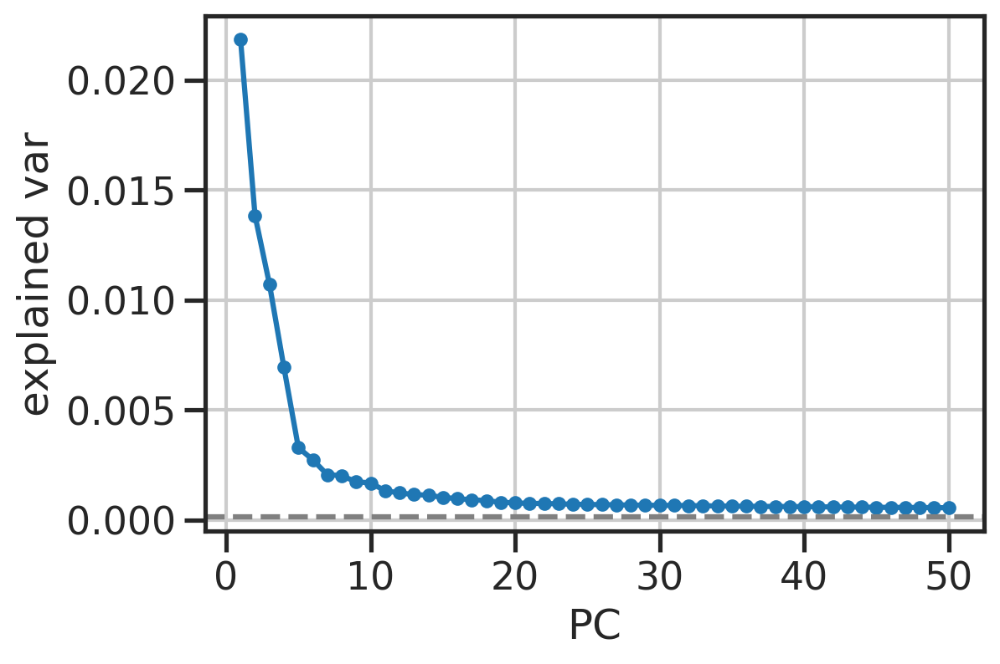

In [18]:
fig, ax = plt.subplots(figsize=(6,4))
ax.plot(np.arange(len(pca.explained_variance_ratio_))+1, pca.explained_variance_ratio_, '-o', markersize=5)
ax.axhline(1/lognorm.shape[1], linestyle='--', color='gray')
ax.set_xlabel('PC')
ax.set_ylabel('explained var')

In [19]:
colors2 = sns.color_palette('tab10', 10)
colors2

[(0.12156862745098039, 0.4666666666666667, 0.7058823529411765),
 (1.0, 0.4980392156862745, 0.054901960784313725),
 (0.17254901960784313, 0.6274509803921569, 0.17254901960784313),
 (0.8392156862745098, 0.15294117647058825, 0.1568627450980392),
 (0.5803921568627451, 0.403921568627451, 0.7411764705882353),
 (0.5490196078431373, 0.33725490196078434, 0.29411764705882354),
 (0.8901960784313725, 0.4666666666666667, 0.7607843137254902),
 (0.4980392156862745, 0.4980392156862745, 0.4980392156862745),
 (0.7372549019607844, 0.7411764705882353, 0.13333333333333333),
 (0.09019607843137255, 0.7450980392156863, 0.8117647058823529)]

In [20]:
colors = sns.color_palette('tab20', 10)
# 6-9
palette_biosamp = {
    'P28_1': colors[6],
    'P28_2': colors[7],
    'P28_dr_1': colors[8],
    'P28_dr_3': colors[9],
}
palette_cond = {
    'P28NR': colors[6],
    'P28DR': colors[8],
}

# 0-5
palette_type = {
    'L2/3_A': colors[0],
    'L2/3_B': colors[2],
    'L2/3_C': colors[4],
    
    'L2/3_1': colors[1],
    'L2/3_2': colors[3],
    'L2/3_3': colors[5],
    'bg': 'lightgray',
}

palette_type_abc = {
    'L2/3_A': colors[0],
    'L2/3_B': colors[2],
    'L2/3_C': colors[4],
    
    'L2/3_1': 'lightgray',
    'L2/3_2': 'lightgray',
    'L2/3_3': 'lightgray',
}

palette_type2 = {}
palette_type2['L2/3_A'] = 'C0' # palette_type['L2/3_A']
palette_type2['L2/3_B'] = 'C1' # palette_type['L2/3_B']
palette_type2['L2/3_C'] = 'C2' # palette_type['L2/3_C']

palette_type2['L2/3_1'] = 'C5' # palette_type['L2/3_A']
palette_type2['L2/3_2'] = 'C6' # palette_type['L2/3_B']
palette_type2['L2/3_3'] = 'C8' # palette_type['L2/3_C']

colors

[(0.12156862745098039, 0.4666666666666667, 0.7058823529411765),
 (0.6823529411764706, 0.7803921568627451, 0.9098039215686274),
 (1.0, 0.4980392156862745, 0.054901960784313725),
 (1.0, 0.7333333333333333, 0.47058823529411764),
 (0.17254901960784313, 0.6274509803921569, 0.17254901960784313),
 (0.596078431372549, 0.8745098039215686, 0.5411764705882353),
 (0.8392156862745098, 0.15294117647058825, 0.1568627450980392),
 (1.0, 0.596078431372549, 0.5882352941176471),
 (0.5803921568627451, 0.403921568627451, 0.7411764705882353),
 (0.7725490196078432, 0.6901960784313725, 0.8352941176470589)]

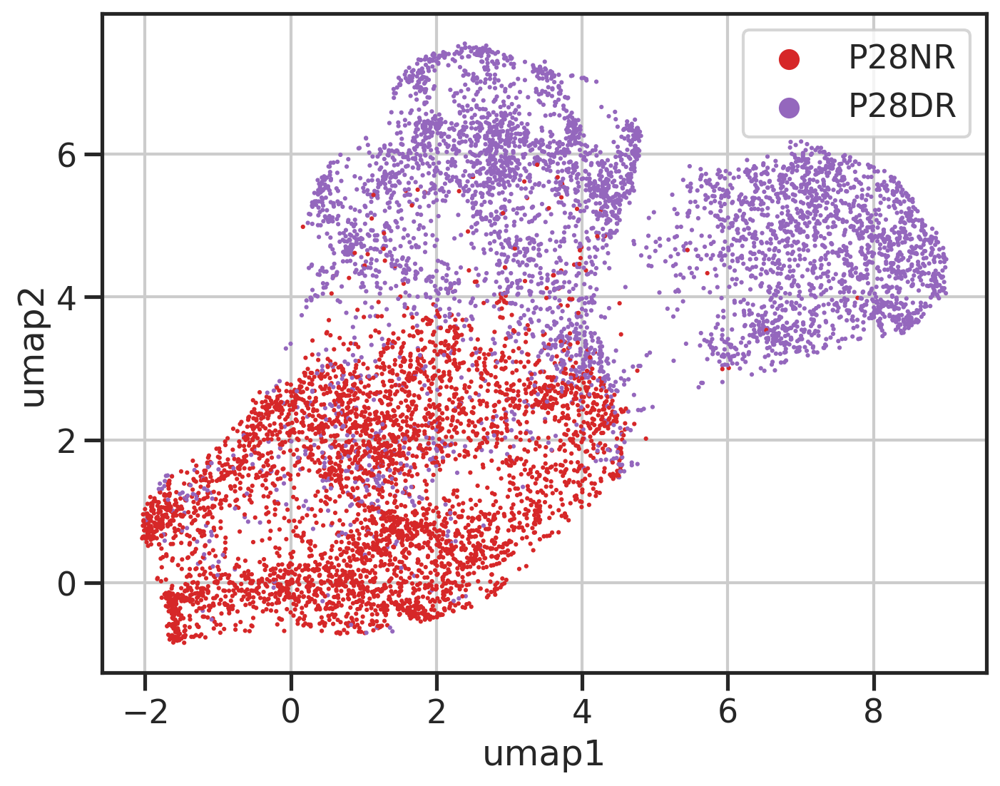

In [21]:
fig, ax = plt.subplots(1,1,figsize=(8*1,6))
sns.scatterplot(data=res.sample(frac=1, replace=False), 
                x='umap1', y='umap2', 
                hue='cond',
                hue_order=list(palette_cond.keys()),
                palette=palette_cond,
                s=5, edgecolor='none', 
                # legend=False,
                ax=ax,
               )
ax.legend(bbox_to_anchor=(1,1))
plt.show()

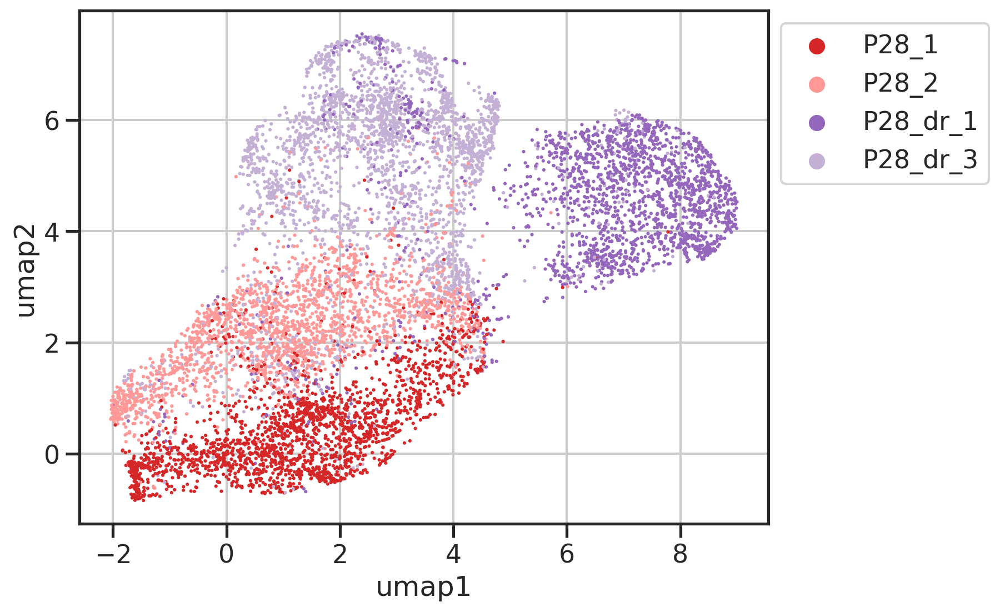

In [22]:

fig, ax = plt.subplots(1,1,figsize=(8*1,6))
sns.scatterplot(data=res.sample(frac=1, replace=False), 
                x='umap1', y='umap2', 
                hue='biosamp',
                hue_order=list(palette_biosamp.keys()),
                palette=palette_biosamp,
                s=5, edgecolor='none', 
                # legend=False,
                ax=ax,
                rasterized=True,
               )
ax.legend(bbox_to_anchor=(1,1))
output = os.path.join(outfigdir, "umap_nrdr.pdf")
powerplots.savefig(fig, output)
plt.show()

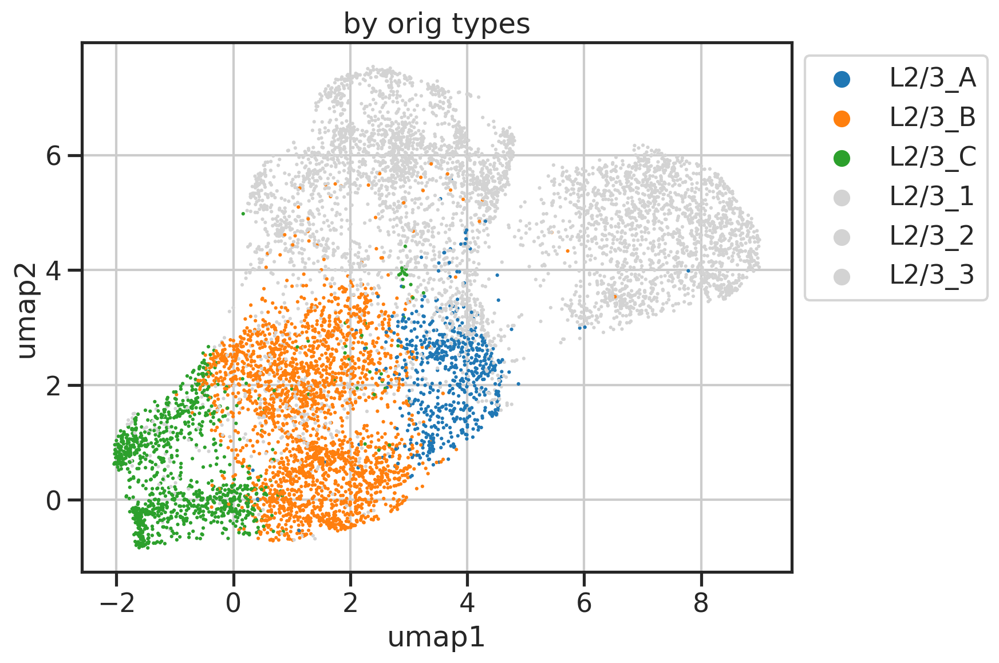

In [23]:
fig, ax = plt.subplots(1,1,figsize=(8*1,6))
sns.scatterplot(data=res.sample(frac=1, replace=False), 
                x='umap1', y='umap2', 
                hue='type',
                hue_order=list(palette_type_abc.keys()),
                palette=palette_type_abc,
                s=5, edgecolor='none', 
                # legend=False,
                ax=ax,
               )
ax.legend(bbox_to_anchor=(1,1))
ax.set_title('by orig types')
plt.show()

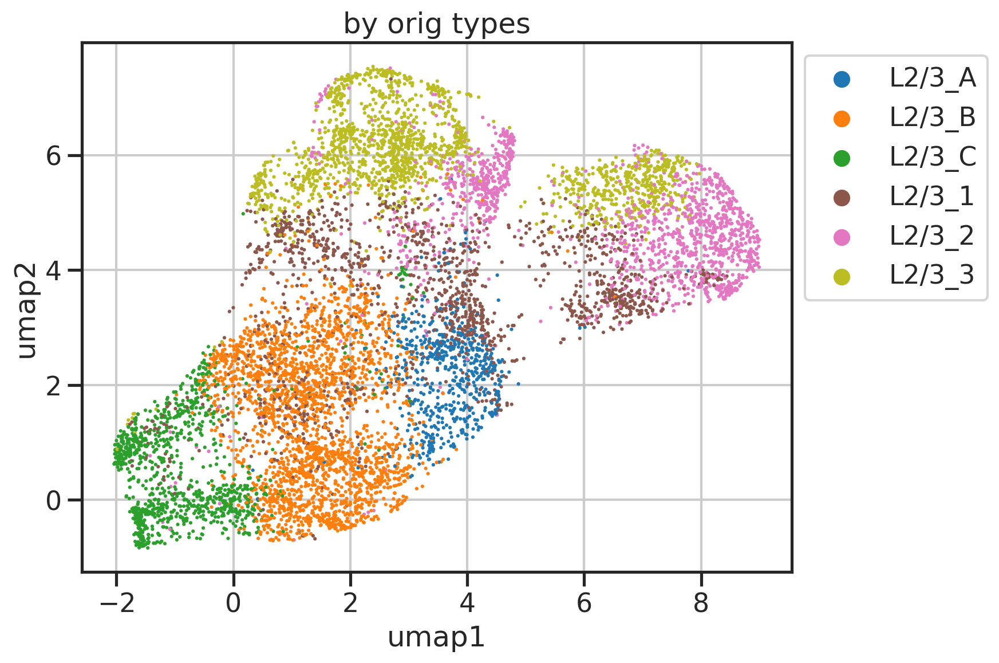

In [24]:
fig, ax = plt.subplots(1,1,figsize=(8*1,6))
sns.scatterplot(data=res.sample(frac=1, replace=False), 
                x='umap1', y='umap2', 
                hue='type',
                hue_order=list(palette_type2.keys()),
                palette=palette_type2,
                s=5, edgecolor='none', 
                # legend=False,
                ax=ax,
                rasterized=True,
               )
ax.legend(bbox_to_anchor=(1,1))
ax.set_title('by orig types')
output = os.path.join(outfigdir, "umap_nrdr_types.pdf")
powerplots.savefig(fig, output)
plt.show()

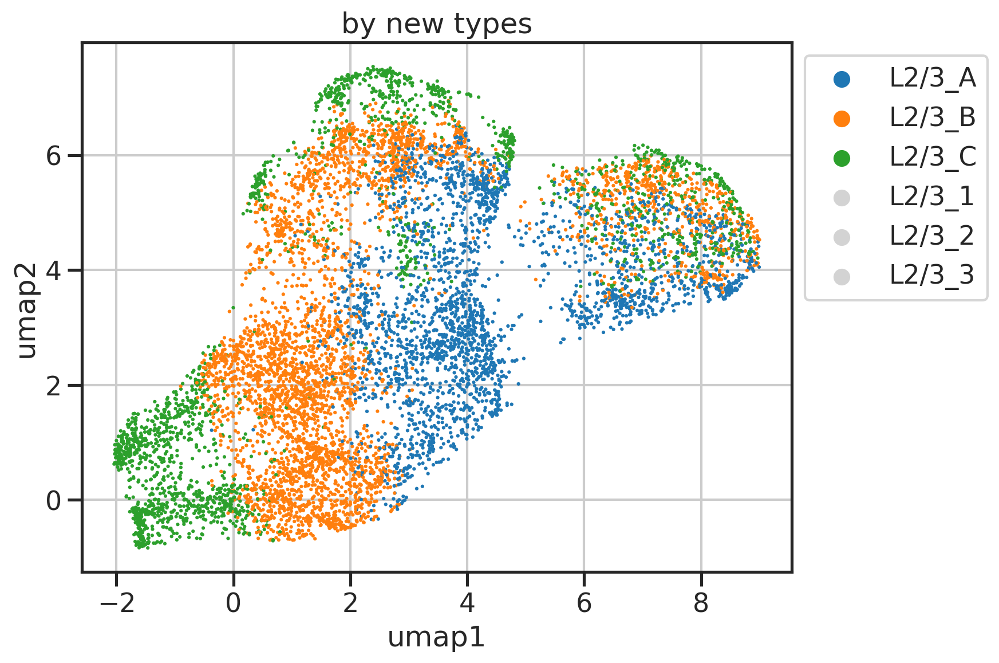

In [25]:
fig, ax = plt.subplots(1,1,figsize=(8*1,6))
sns.scatterplot(data=res.sample(frac=1, replace=False), 
                x='umap1', y='umap2', 
                hue='newtype',
                hue_order=list(palette_type_abc.keys()),
                palette=palette_type_abc,
                s=5, edgecolor='none', 
                # legend=False,
                ax=ax,
               )
ax.legend(bbox_to_anchor=(1,1))
ax.set_title('by new types')
output = os.path.join(outfigdir, "umap_nrdr_newtypes.pdf")
powerplots.savefig(fig, output)
plt.show()

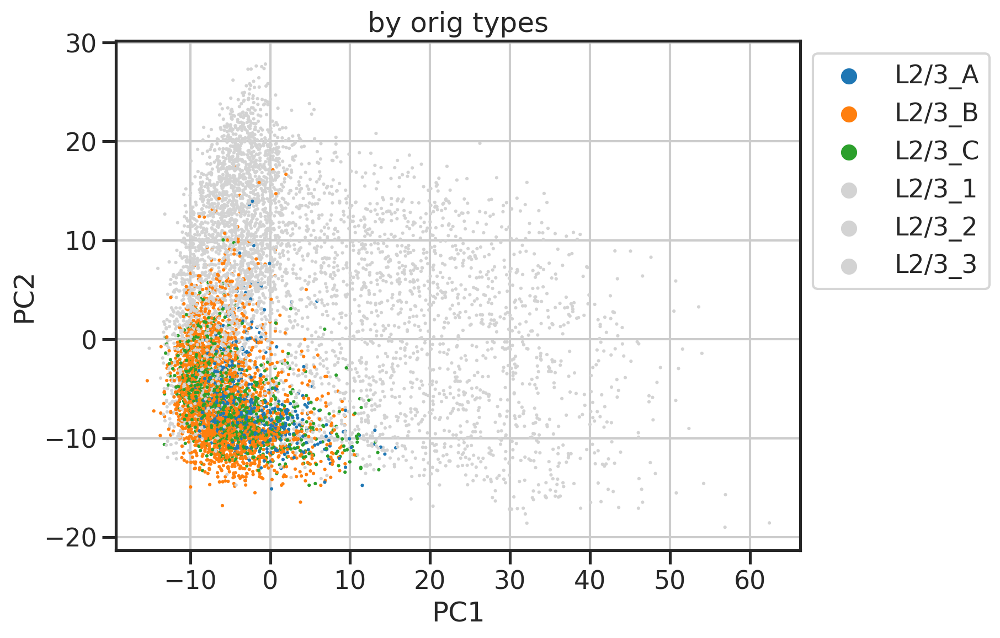

In [26]:
fig, ax = plt.subplots(1,1,figsize=(8*1,6))
sns.scatterplot(data=res.sample(frac=1, replace=False), 
                x='PC1', y='PC2', 
                hue='type',
                hue_order=list(palette_type_abc.keys()),
                palette=palette_type_abc,
                s=5, edgecolor='none', 
                # legend=False,
                ax=ax,
               )
ax.legend(bbox_to_anchor=(1,1))
ax.set_title('by orig types')
plt.show()

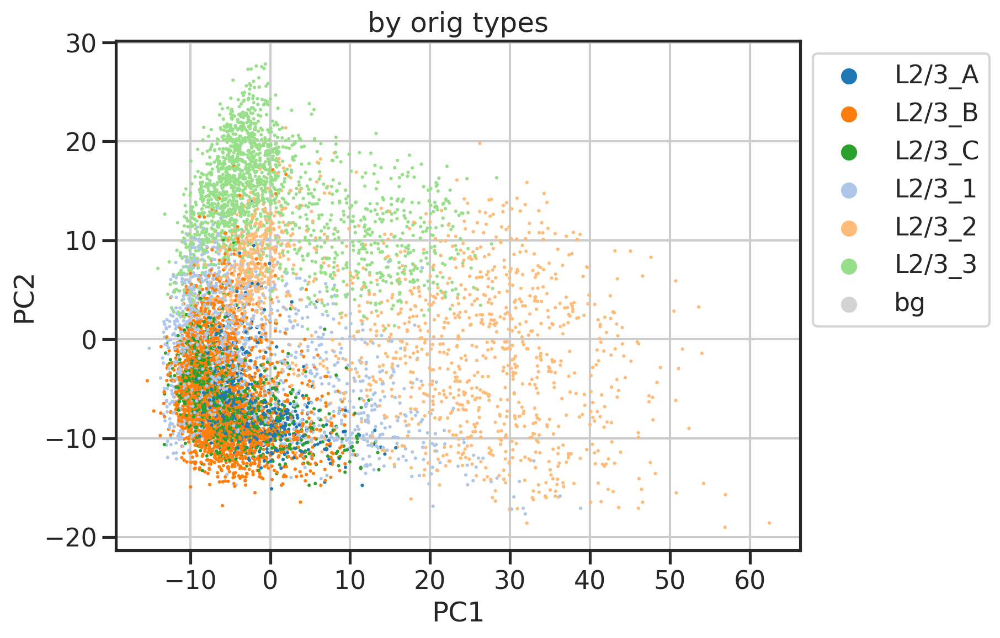

In [27]:
fig, ax = plt.subplots(1,1,figsize=(8*1,6))
sns.scatterplot(data=res.sample(frac=1, replace=False), 
                x='PC1', y='PC2', 
                hue='type',
                hue_order=list(palette_type.keys()),
                palette=palette_type,
                s=5, edgecolor='none', 
                # legend=False,
                ax=ax,
               )
ax.legend(bbox_to_anchor=(1,1))
ax.set_title('by orig types')
plt.show()

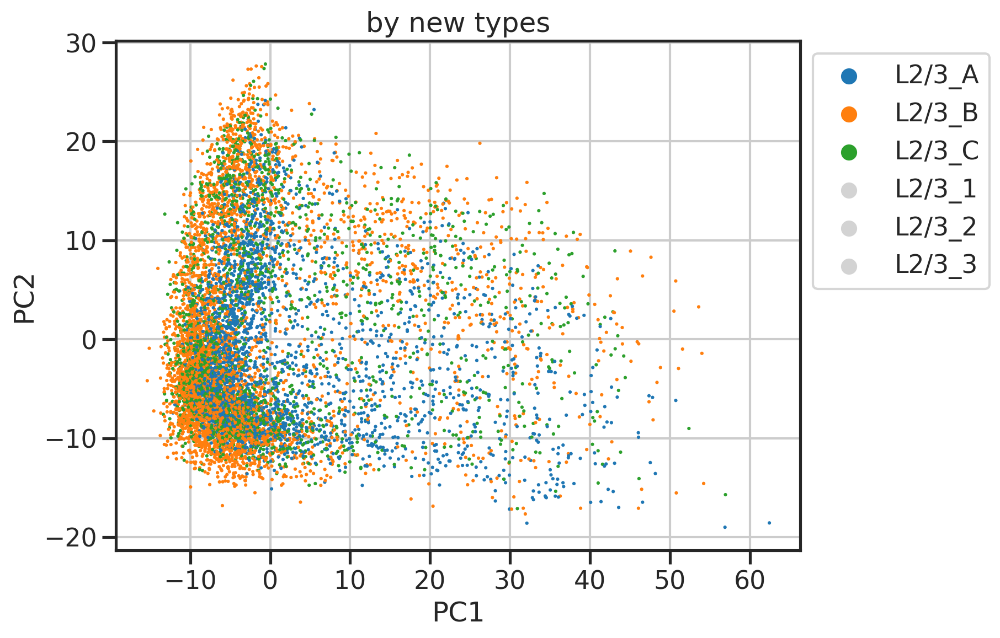

In [28]:
fig, ax = plt.subplots(1,1,figsize=(8*1,6))
sns.scatterplot(data=res.sample(frac=1, replace=False), 
                x='PC1', y='PC2', 
                hue='newtype',
                hue_order=list(palette_type_abc.keys()),
                palette=palette_type_abc,
                s=5, edgecolor='none', 
                # legend=False,
                ax=ax,
               )
ax.legend(bbox_to_anchor=(1,1))
ax.set_title('by new types')
plt.show()

In [29]:
def plot_pcs(res, npc, hue, palette=None):
    fig, axs = plt.subplots(npc-1,npc-1,figsize=(6*(npc-1),5*(npc-1)))
    for i, j in itertools.combinations(range(npc), 2):
        legend = False
        if (i,j) == (0,1): legend=True

        x, y = f"PC{j+1}", f"PC{i+1}"
        ax = axs[i,j-1]
        
        if palette is not None:
            sns.scatterplot(data=res.sample(frac=1, replace=False), 
                            x=x, y=y, 
                            hue=hue,
                            hue_order=list(palette.keys()),
                            palette=palette,
                            s=5, edgecolor='none', 
                            legend=legend,
                            ax=ax,
                           )
        else:
            sns.scatterplot(data=res.sample(frac=1, replace=False), 
                            x=x, y=y, 
                            hue=hue,
                            # hue_order=list(palette.keys()),
                            # palette=palette,
                            s=5, edgecolor='none', 
                            legend=legend,
                            ax=ax,
                           )
        sns.despine(ax=ax)
    axs[0,0].legend(bbox_to_anchor=(0.5, -0.2), loc='upper center')

    for i, j in itertools.product(range(npc-1), range(npc-1)):
        if j<i:
            ax = axs[i,j]
            ax.axis('off')

    plt.show()

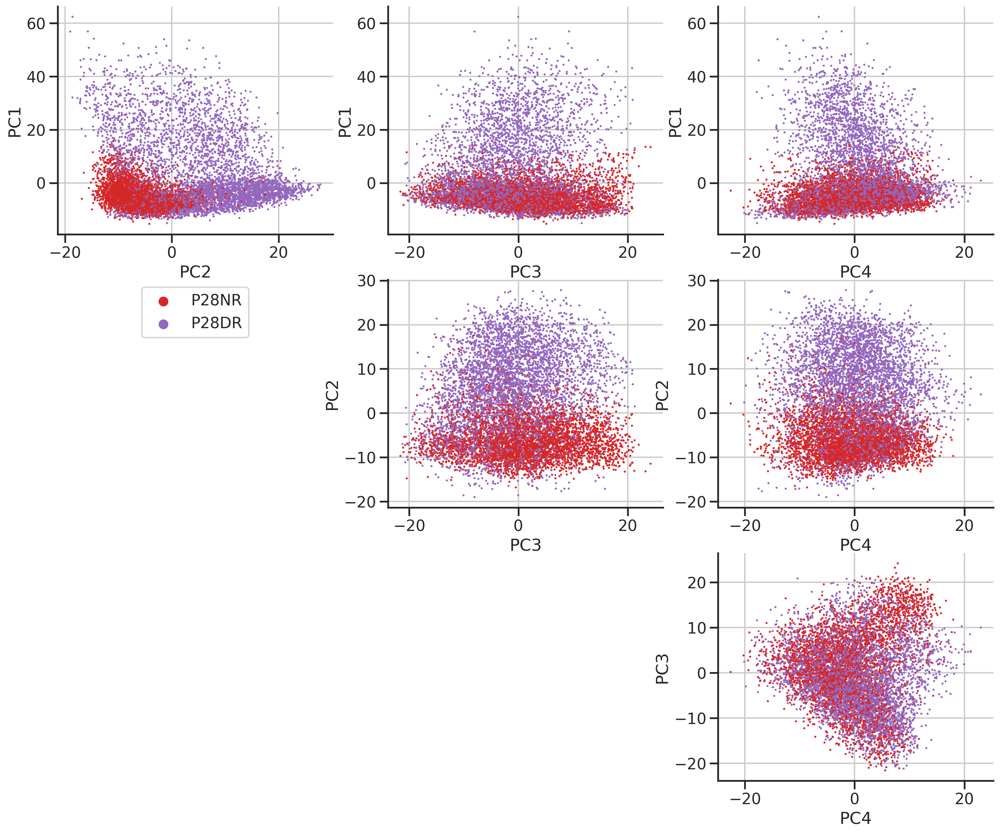

In [30]:
plot_pcs(res, 4, 'cond', palette=palette_cond)

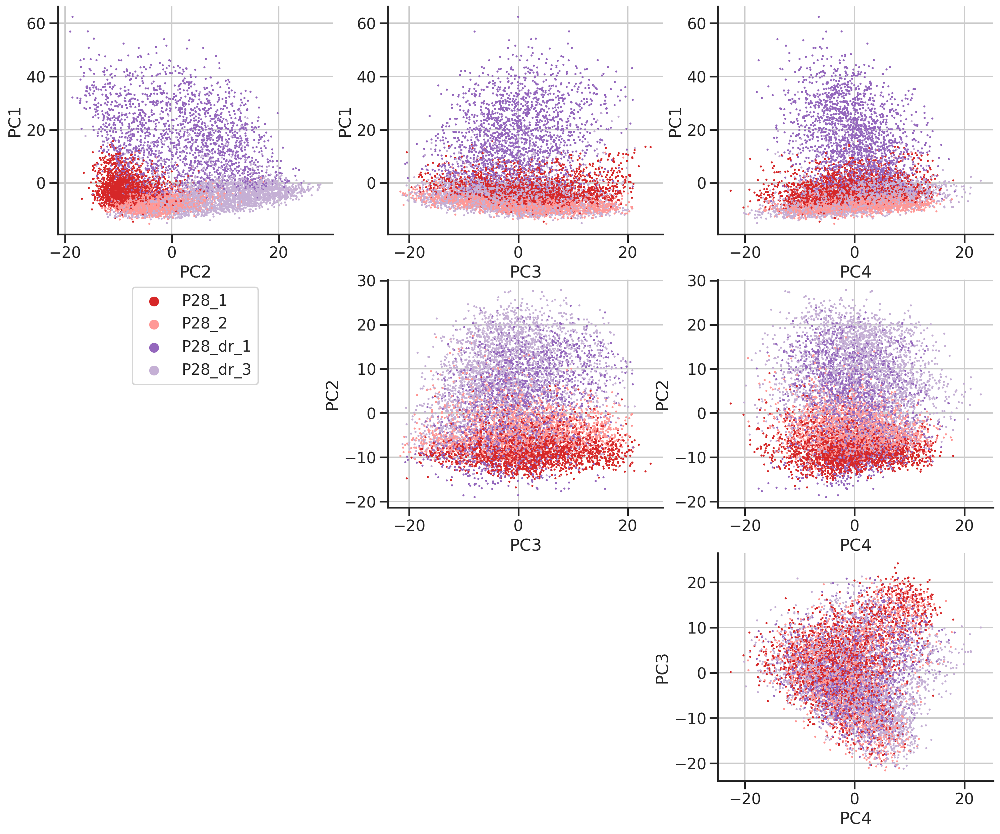

In [31]:
plot_pcs(res, 4, 'biosamp', palette=palette_biosamp)

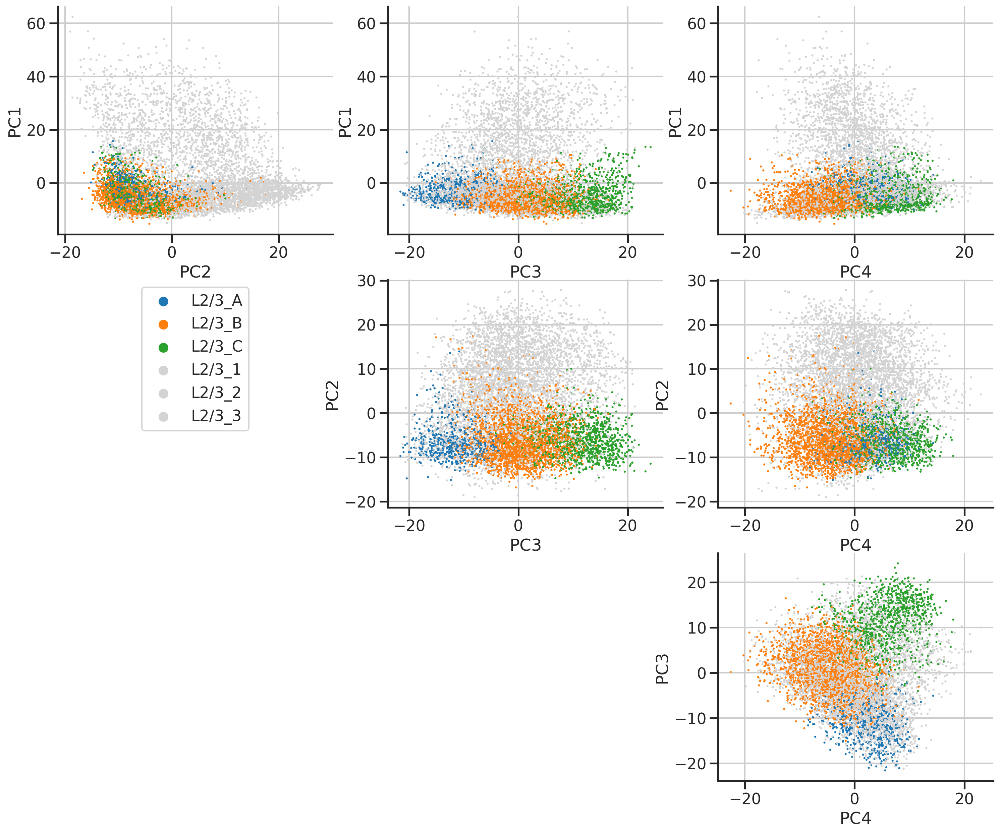

In [32]:
plot_pcs(res, 4, 'type', palette=palette_type_abc)

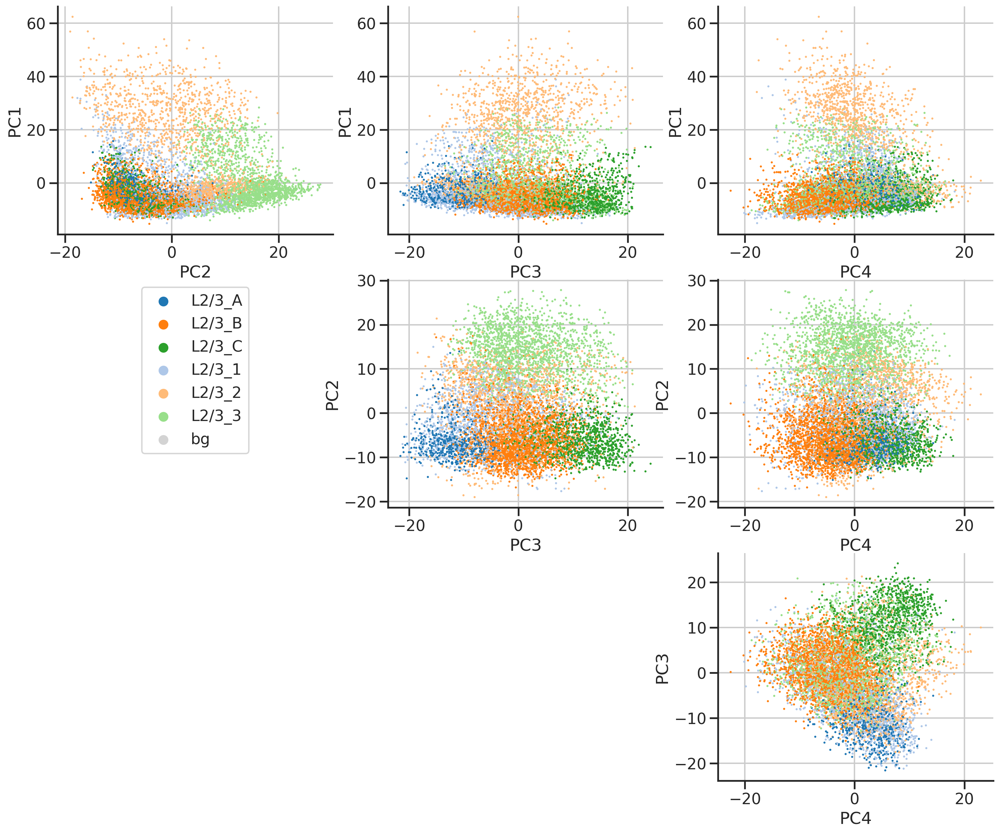

In [33]:
plot_pcs(res, 4, 'type', palette=palette_type)

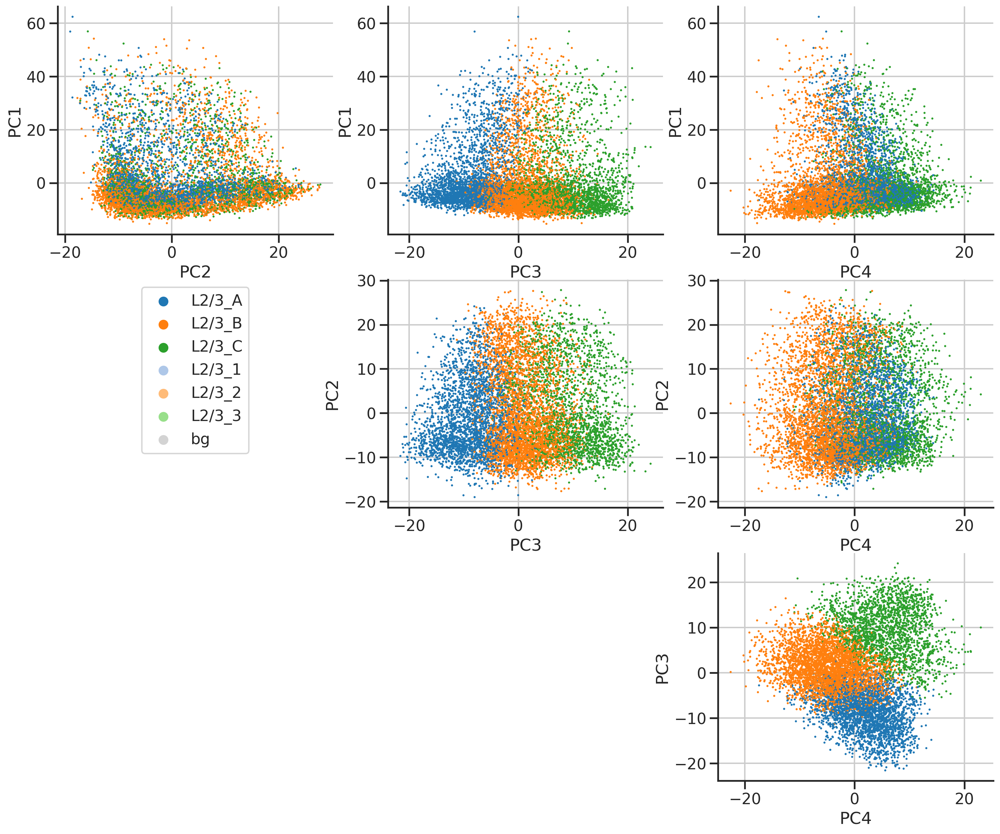

In [34]:
plot_pcs(res, 4, 'newtype', palette=palette_type)

In [35]:
res['newtype2'] = res['newtype'].copy()
res.loc[res['cond']=='P28DR', 'newtype2'] = res.loc[res['cond']=='P28DR', 'newtype2'] + 'p'

res['newtype_nr'] = res['newtype'].copy()
res.loc[res['cond']=='P28DR', 'newtype_nr'] = 'bg'

res['newtype_dr'] = res['newtype'].copy()
res.loc[res['cond']=='P28NR', 'newtype_dr'] = 'bg'

res['type_dr'] = res['type'].copy().astype(str)
res.loc[res['cond']=='P28NR', 'type_dr'] = 'bg'

In [36]:
res[res['cond']=='P28DR']['type'].unique()

['L2/3_3', 'L2/3_1', 'L2/3_2']
Categories (6, object): ['L2/3_1', 'L2/3_2', 'L2/3_3', 'L2/3_A', 'L2/3_B', 'L2/3_C']

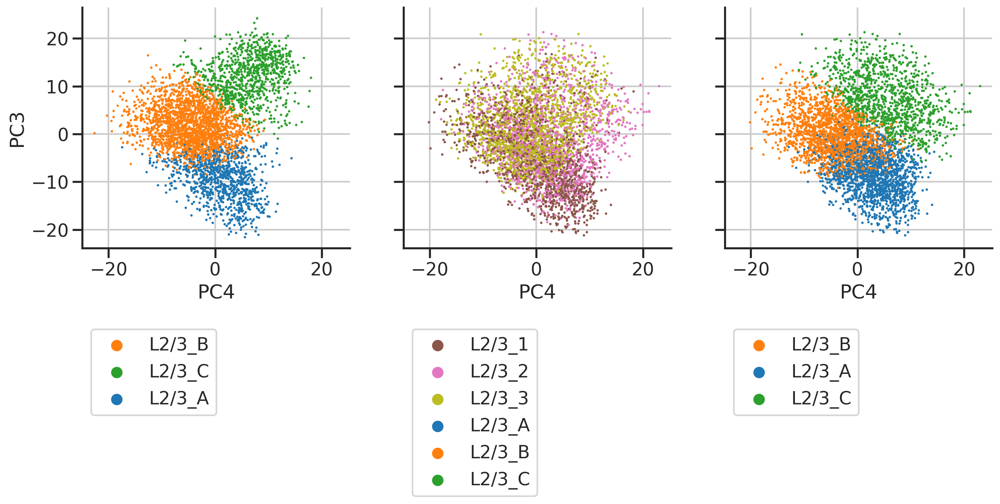

In [37]:
fig, axs = plt.subplots(1,3,figsize=(3*5, 1*4), sharex=True, sharey=True)
ax = axs[0]
sns.scatterplot(data=res[res['cond']=='P28NR'], x='PC4', y='PC3', hue='newtype', s=5, 
                edgecolor='none', palette=palette_type, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
sns.despine(ax=ax)

ax = axs[1]
sns.scatterplot(data=res[res['cond']=='P28DR'], x='PC4', y='PC3', hue='type', s=5, 
                edgecolor='none', palette=palette_type2, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
sns.despine(ax=ax)

ax = axs[2]
sns.scatterplot(data=res[res['cond']=='P28DR'], x='PC4', y='PC3', hue='newtype', s=5, 
                edgecolor='none', palette=palette_type, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
sns.despine(ax=ax)

output = os.path.join(outfigdir, "fig1_pc34.pdf")
powerplots.savefig(fig, output)
plt.show()

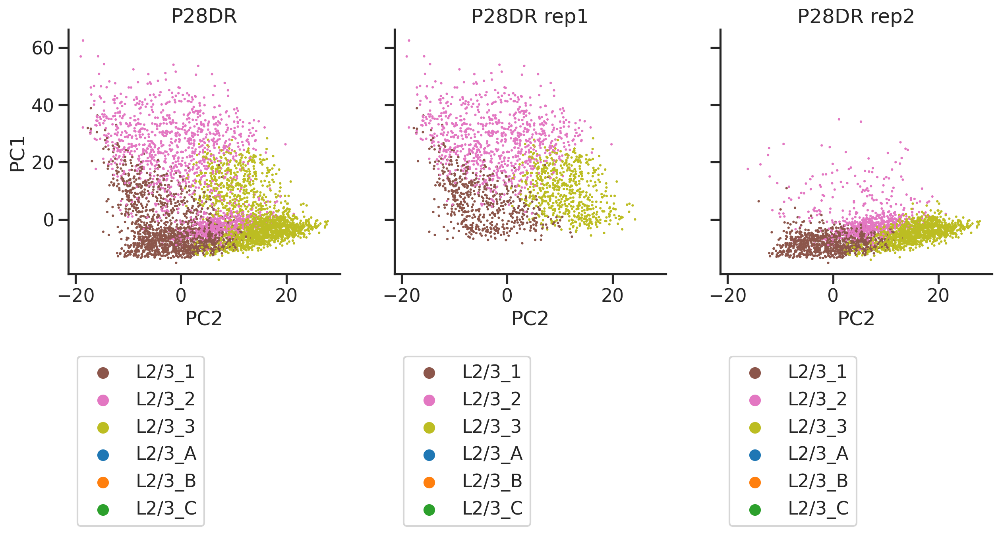

In [38]:
fig, axs = plt.subplots(1,3,figsize=(3*5, 1*4), sharex=True, sharey=True)
ax = axs[0]
sns.scatterplot(data=res[res['cond']=='P28DR'], x='PC2', y='PC1', hue='type', s=5, 
                edgecolor='none', palette=palette_type2, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
sns.despine(ax=ax)
ax.grid(False)
ax.set_title('P28DR')

ax = axs[1]
sns.scatterplot(data=res[res['biosamp']=='P28_dr_1'], x='PC2', y='PC1', hue='type', s=5, 
                edgecolor='none', palette=palette_type2, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
sns.despine(ax=ax)
ax.grid(False)
ax.set_title('P28DR rep1')

ax = axs[2]
sns.scatterplot(data=res[res['biosamp']=='P28_dr_3'], x='PC2', y='PC1', hue='type', s=5, 
                edgecolor='none', palette=palette_type2, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
sns.despine(ax=ax)
ax.grid(False)
ax.set_title('P28DR rep2')

output = os.path.join(outfigdir, "figS1_dr_pc12.pdf")
powerplots.savefig(fig, output)
plt.show()

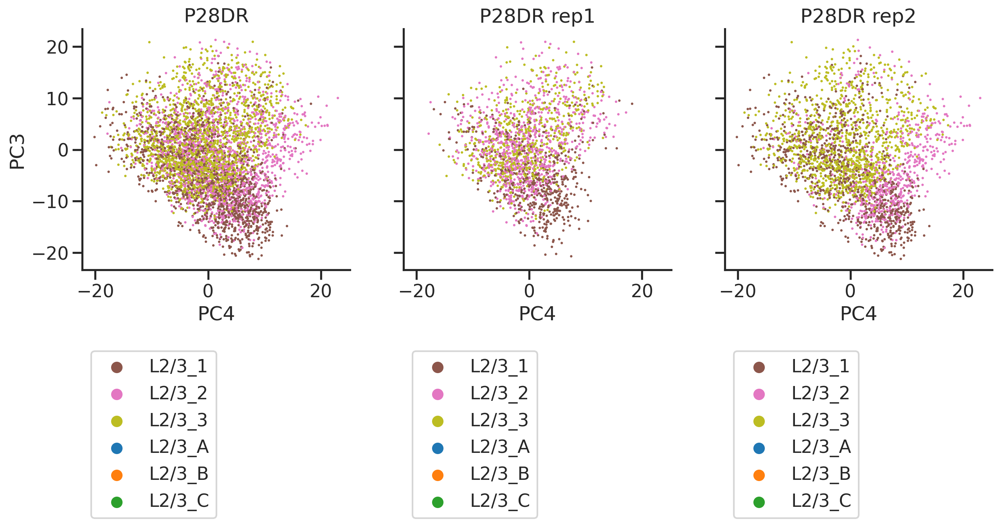

In [39]:
fig, axs = plt.subplots(1,3,figsize=(3*5, 1*4), sharex=True, sharey=True)
ax = axs[0]
sns.scatterplot(data=res[res['cond']=='P28DR'], x='PC4', y='PC3', hue='type', s=5, 
                edgecolor='none', palette=palette_type2, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
sns.despine(ax=ax)
ax.grid(False)
ax.set_title('P28DR')

ax = axs[1]
sns.scatterplot(data=res[res['biosamp']=='P28_dr_1'], x='PC4', y='PC3', hue='type', s=5, 
                edgecolor='none', palette=palette_type2, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
sns.despine(ax=ax)
ax.grid(False)
ax.set_title('P28DR rep1')

ax = axs[2]
sns.scatterplot(data=res[res['biosamp']=='P28_dr_3'], x='PC4', y='PC3', hue='type', s=5, 
                edgecolor='none', palette=palette_type2, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
sns.despine(ax=ax)
ax.grid(False)
ax.set_title('P28DR rep2')

output = os.path.join(outfigdir, "figS1_dr_pc34.pdf")
powerplots.savefig(fig, output)
plt.show()

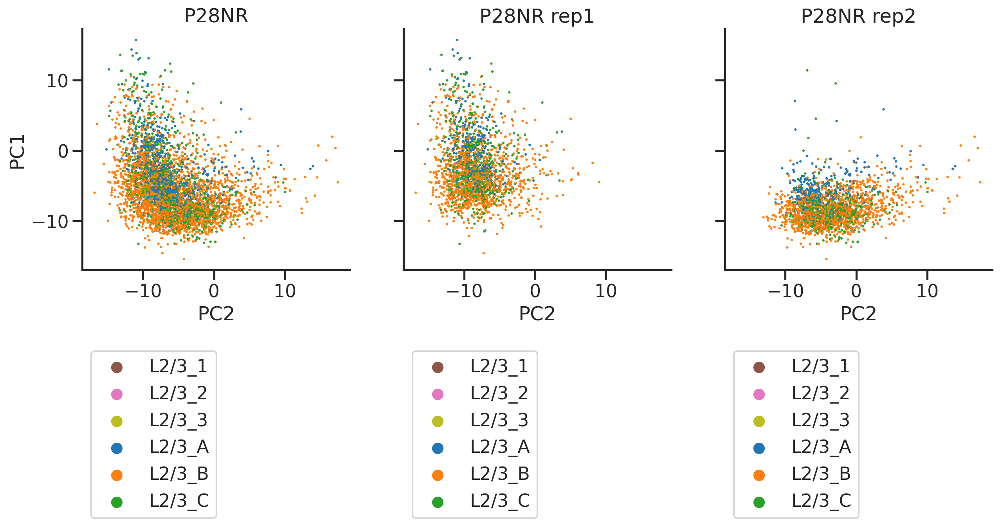

In [40]:
fig, axs = plt.subplots(1,3,figsize=(3*5, 1*4), sharex=True, sharey=True)
ax = axs[0]
sns.scatterplot(data=res[res['cond']=='P28NR'], x='PC2', y='PC1', hue='type', s=5, 
                edgecolor='none', palette=palette_type2, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
sns.despine(ax=ax)
ax.grid(False)
ax.set_title('P28NR')

ax = axs[1]
sns.scatterplot(data=res[res['biosamp']=='P28_1'], x='PC2', y='PC1', hue='type', s=5, 
                edgecolor='none', palette=palette_type2, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
sns.despine(ax=ax)
ax.grid(False)
ax.set_title('P28NR rep1')

ax = axs[2]
sns.scatterplot(data=res[res['biosamp']=='P28_2'], x='PC2', y='PC1', hue='type', s=5, 
                edgecolor='none', palette=palette_type2, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
sns.despine(ax=ax)
ax.grid(False)
ax.set_title('P28NR rep2')

output = os.path.join(outfigdir, "figS1_nr_pc12.pdf")
powerplots.savefig(fig, output)
plt.show()

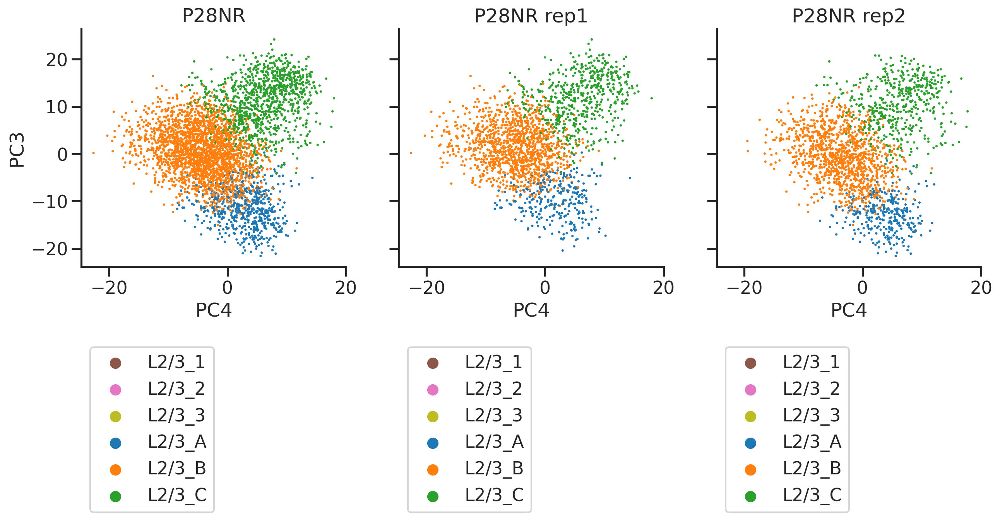

In [41]:
fig, axs = plt.subplots(1,3,figsize=(3*5, 1*4), sharex=True, sharey=True)
ax = axs[0]
sns.scatterplot(data=res[res['cond']=='P28NR'], x='PC4', y='PC3', hue='type', s=5, 
                edgecolor='none', palette=palette_type2, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
sns.despine(ax=ax)
ax.grid(False)
ax.set_title('P28NR')

ax = axs[1]
sns.scatterplot(data=res[res['biosamp']=='P28_1'], x='PC4', y='PC3', hue='type', s=5, 
                edgecolor='none', palette=palette_type2, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
sns.despine(ax=ax)
ax.grid(False)
ax.set_title('P28NR rep1')

ax = axs[2]
sns.scatterplot(data=res[res['biosamp']=='P28_2'], x='PC4', y='PC3', hue='type', s=5, 
                edgecolor='none', palette=palette_type2, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
sns.despine(ax=ax)
ax.grid(False)
ax.set_title('P28NR rep2')

output = os.path.join(outfigdir, "figS1_nr_pc34.pdf")
powerplots.savefig(fig, output)
plt.show()

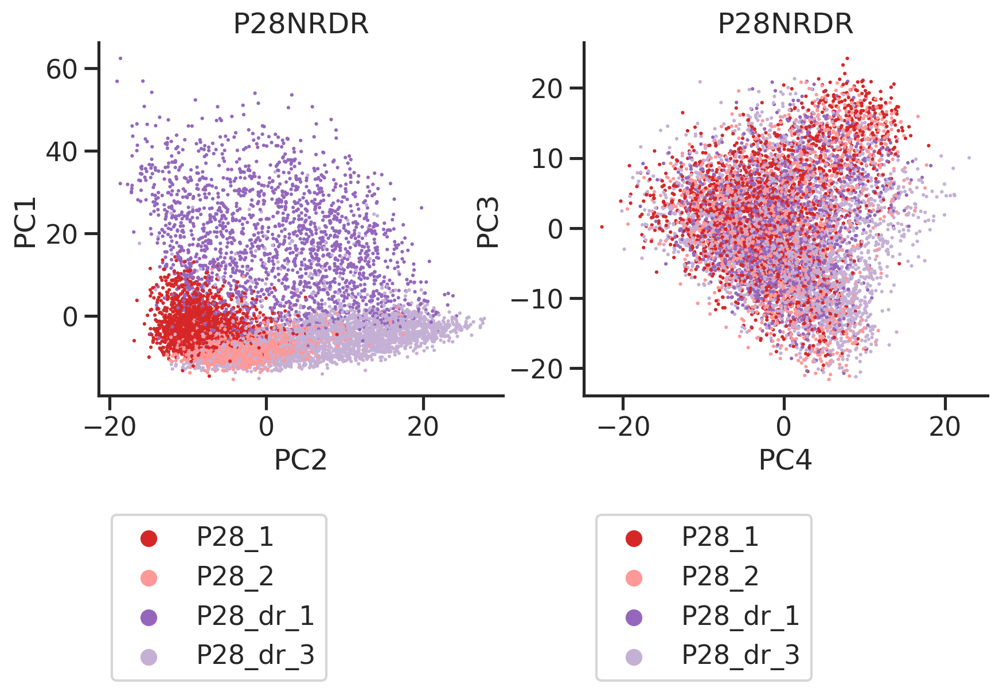

In [42]:

fig, axs = plt.subplots(1,2,figsize=(2*5, 1*4))
ax = axs[0]
sns.scatterplot(data=res.sample(frac=1, replace=False), x='PC2', y='PC1', hue='biosamp', s=5, 
                edgecolor='none', hue_order=list(palette_biosamp), palette=palette_biosamp, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
sns.despine(ax=ax)
ax.grid(False)
ax.set_title('P28NRDR')

ax = axs[1]
sns.scatterplot(data=res.sample(frac=1, replace=False), x='PC4', y='PC3', hue='biosamp', s=5, 
                edgecolor='none', hue_order=list(palette_biosamp), palette=palette_biosamp, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
sns.despine(ax=ax)
ax.grid(False)
ax.set_title('P28NRDR')

output = os.path.join(outfigdir, "figS1_pc12.pdf")
powerplots.savefig(fig, output)
plt.show()

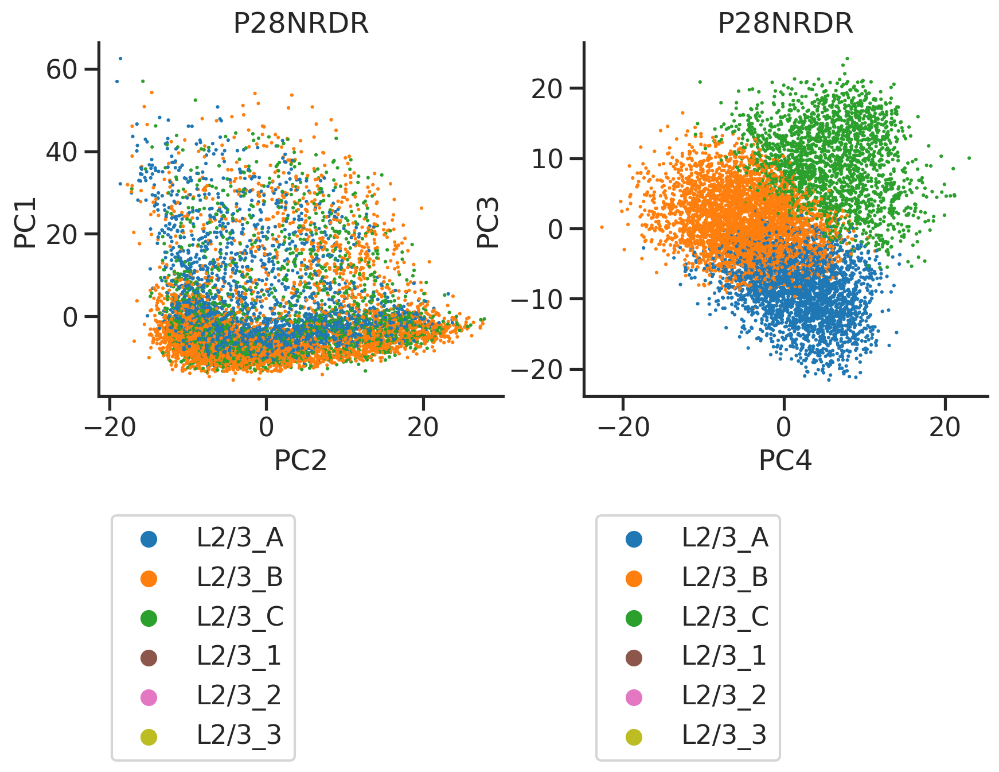

In [43]:

fig, axs = plt.subplots(1,2,figsize=(2*5, 1*4))
ax = axs[0]
sns.scatterplot(data=res.sample(frac=1, replace=False), x='PC2', y='PC1', hue='newtype', s=5, 
                edgecolor='none', hue_order=list(palette_type2), palette=palette_type2, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
sns.despine(ax=ax)
ax.grid(False)
ax.set_title('P28NRDR')

ax = axs[1]
sns.scatterplot(data=res.sample(frac=1, replace=False), x='PC4', y='PC3', hue='newtype', s=5, 
                edgecolor='none', hue_order=list(palette_type2), palette=palette_type2, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
sns.despine(ax=ax)
ax.grid(False)
ax.set_title('P28NRDR')

output = os.path.join(outfigdir, "figS1_pc34_newtype.pdf")
powerplots.savefig(fig, output)
plt.show()

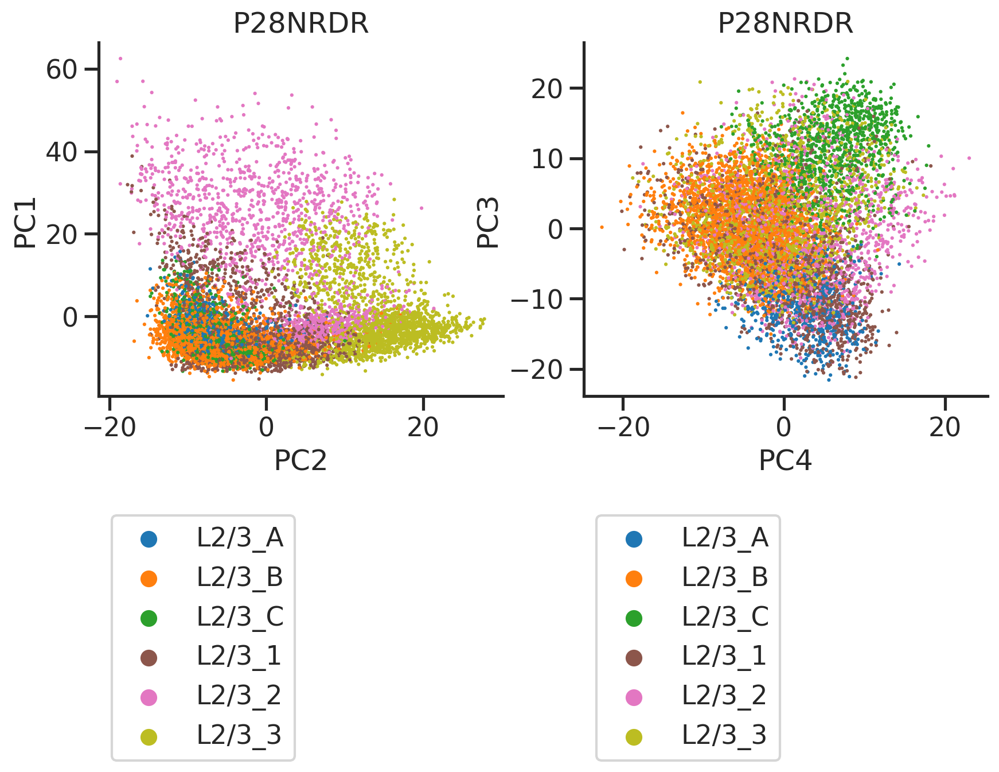

In [44]:

fig, axs = plt.subplots(1,2,figsize=(2*5, 1*4))
ax = axs[0]
sns.scatterplot(data=res.sample(frac=1, replace=False), x='PC2', y='PC1', hue='type', s=5, 
                edgecolor='none', hue_order=list(palette_type2), palette=palette_type2, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
sns.despine(ax=ax)
ax.grid(False)
ax.set_title('P28NRDR')

ax = axs[1]
sns.scatterplot(data=res.sample(frac=1, replace=False), x='PC4', y='PC3', hue='type', s=5, 
                edgecolor='none', hue_order=list(palette_type2), palette=palette_type2, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
sns.despine(ax=ax)
ax.grid(False)
ax.set_title('P28NRDR')

output = os.path.join(outfigdir, "figS1_pc34_type.pdf")
powerplots.savefig(fig, output)
plt.show()